## Read Data

In [1]:
pid_list = list(range(1,19))
data = {}
for pid in pid_list:
    data[pid] = {}
    for attempt in range(1, 7):
        fileName = 'roadData/' + str(pid) + '-' + str(attempt) + '/carData_track0.txt'
        try:
            with open(fileName, 'r') as f:
                data[pid][attempt] = f.read().split('\n')
        except:
            print('Error: file {} not found!'.format(fileName))
data

{1: {1: ['Driving Task: assets/DrivingTasks/Projects/LaneChangeTest/laneChangeTest.xml',
   'Date-Time: 2022_07_22-18_10_02',
   'Driver: TestDriver',
   'Used Format = Time (ms): Position (x,y,z) : Rotation (x,y,z,w) : Speed (km/h) : Steering Wheel Position [-1,1] : Gas Pedal Position : Brake Pedal Position : Engine Running : Distance Ahead (meters): Time To Collision (sec) : Headway Time (sec)',
   '1658527802096:1501.634:-0.442:260.85:0.0011:0.7068:-0.0011:0.7074:53.16:-7.5E-4:0.9882811:0.0:true:0.0:0.0:0.0',
   '1658527802144:1500.443:-0.442:260.848:0.0011:0.7067:-0.0011:0.7075:53.94:-7.5E-4:0.988281:0.0:true:0.0:0.0:0.0',
   '1658527802189:1499.841:-0.442:260.847:0.0011:0.7066:-0.0011:0.7076:54.33:-7.5E-4:0.98828113:0.0:true:0.0:0.0:0.0',
   '1658527802242:1499.082:-0.442:260.846:0.0011:0.7065:-0.0011:0.7077:54.82:-7.5E-4:0.9882811:0.0:true:0.0:0.0:0.0',
   '1658527802295:1498.163:-0.442:260.844:0.0011:0.7064:-0.0011:0.7078:55.41:-7.5E-4:0.98828113:0.0:true:0.0:0.0:0.0',
   '16585

## Get Info (timestamp, X, Z, speed)

In [2]:
def get_info(page):
    info = []
    for i in range(4, len(page)-1):
        line = page[i].split(':')
        info.append([line[0], line[1], line[3], line[8]])
    return info

In [3]:
info = {}
for pid in pid_list:
    info[pid] = {'Tap': [], 'Swipe': [], 'Air': []}
    for attempt in range(1, 7):
#         print('PID: {}\t ATT:{}'.format(pid, attempt))
        # tap
        if (pid % 6 in [0, 3] and attempt in [1, 2]) or (pid % 6 in [1, 5] and attempt in [3, 4]) or (pid % 6 in [2, 4] and attempt in [5, 6]):
            info[pid]['Tap'].append(get_info(data[pid][attempt]))
        # swipe
        if (pid % 6 in [2, 5] and attempt in [1, 2]) or (pid % 6 in [0, 4] and attempt in [3, 4]) or (pid % 6 in [1, 3] and attempt in [5, 6]):
            info[pid]['Swipe'].append(get_info(data[pid][attempt]))
        # air
        if (pid % 6 in [1, 4] and attempt in [1, 2]) or (pid % 6 in [2, 3] and attempt in [3, 4]) or (pid % 6 in [0, 5] and attempt in [5, 6]):
            info[pid]['Air'].append(get_info(data[pid][attempt]))
info

{1: {'Tap': [[['1658528193635', '1501.39', '260.417', '55.61'],
    ['1658528193673', '1500.458', '260.425', '56.1'],
    ['1658528193727', '1499.519', '260.433', '56.6'],
    ['1658528193772', '1498.887', '260.439', '56.93'],
    ['1658528193828', '1497.934', '260.447', '57.43'],
    ['1658528193877', '1497.133', '260.454', '57.85'],
    ['1658528193922', '1496.487', '260.46', '58.18'],
    ['1658528193977', '1495.513', '260.468', '58.69'],
    ['1658528194024', '1494.858', '260.474', '59.03'],
    ['1658528194072', '1494.035', '260.481', '59.46'],
    ['1658528194131', '1493.039', '260.49', '59.98'],
    ['1658528194180', '1492.202', '260.496', '60.42'],
    ['1658528194226', '1491.359', '260.503', '60.87'],
    ['1658528194273', '1490.68', '260.509', '61.23'],
    ['1658528194330', '1489.654', '260.517', '61.78'],
    ['1658528194376', '1488.793', '260.524', '62.23'],
    ['1658528194430', '1487.925', '260.531', '62.69'],
    ['1658528194476', '1487.05', '260.538', '63.14'],
    ['1

## Lane and Signs Constants

In [4]:
def getLane(signs):
    lanes = []
    for i in signs:
        if signs[i] == '260.45':
            lanes.append('center')
        elif signs[i] == '264.3' or signs[i] == '264.30':
            lanes.append('right')
        elif signs[i] == '256.6' or signs[i] == '256.60':
            lanes.append('left')
    return lanes

In [5]:
import json
with open('signs.txt', 'r') as f:
    signs = json.load(f)
left, center, right = '256.6', '260.45', '264.3'
signs_x = [float(e) for e in list(signs.keys())]
signs_lane = [float(e) for e in list(signs.values())]
signs_lane_word = getLane(signs)

print('signs X:', signs_x)
print('signs lane number:', signs_lane)
print('signs lane word:', signs_lane_word)

signs X: [1499.0, 1380.0, 1370.0, 1230.0, 1220.0, 1080.0, 1070.0, 930.0, 920.0, 780.0, 770.0, 630.0, 620.0, 480.0, 470.0, 330.0, 320.0, 180.0, 170.0, 30.0, 20.0, -120.0, -130.0, -270.0, -280.0, -420.0, -430.0, -570.0, -580.0, -720.0, -730.0, -870.0, -880.0, -1020.0, -1030.0, -1170.0, -1180.0, -1349.0]
signs lane number: [260.45, 260.45, 264.3, 264.3, 260.45, 260.45, 256.6, 256.6, 260.45, 260.45, 256.6, 256.6, 260.45, 260.45, 256.6, 256.6, 264.3, 264.3, 256.6, 256.6, 260.45, 260.45, 264.3, 264.3, 256.6, 256.6, 264.3, 264.3, 260.45, 260.45, 264.3, 264.3, 260.45, 260.45, 256.6, 256.6, 264.3, 264.3]
signs lane word: ['center', 'center', 'right', 'right', 'center', 'center', 'left', 'left', 'center', 'center', 'left', 'left', 'center', 'center', 'left', 'left', 'right', 'right', 'left', 'left', 'center', 'center', 'right', 'right', 'left', 'left', 'right', 'right', 'center', 'center', 'right', 'right', 'center', 'center', 'left', 'left', 'right', 'right']


## Get Root Mean Squared Error (Lane Distance and Speed)

In [6]:
def remove_outliers(org_df, column):
    import numpy as np
    data = org_df.loc[:,column]
    df = org_df.copy()
    # std
#     datalist = data.tolist()
#     import statistics
#     mu, std = statistics.mean(datalist), statistics.stdev(datalist)
#     max_val = mu + 3*std
#     min_val = mu - 3*std
    # quarters
    q75, q25 = np.percentile(data,[75,25])
    intr_qr = q75-q25
    max_val = q75+(1.5*intr_qr)
    min_val = q25-(1.5*intr_qr)
    # filter
    df.loc[org_df[column] < min_val, column] = 'OL'
    df.loc[org_df[column] > max_val, column] = 'OL'
    return df[df[column] != 'OL']

In [7]:
def get_error_in_lane(information):
    from math import sqrt
    speed_target = 80
    frame_counter, sum_distance, sum_speed, current_sign = 0, 0, 0, 0
    distance_error, speed_error = [], []
    for line in information:
        timestamp, x, z, speed = float(line[0]), float(line[1]), float(line[2]), float(line[3])
        if x < signs_x[current_sign] and x > signs_x[current_sign+1]: # start recording
            sum_distance += pow((z - signs_lane[current_sign]), 2)
            sum_speed += speed
            frame_counter += 1
        if x <= signs_x[current_sign+1]: # end recording
            distance_error.append(sqrt(sum_distance/frame_counter))
            speed_error.append(sum_speed/frame_counter)
            sum_distance, frame_counter, sum_speed = 0, 0, 0
            current_sign += 2
    return sum(distance_error)/len(distance_error), sum(speed_error)/len(speed_error)

In [8]:
import pandas as pd
modes = ['Tap', 'Swipe', 'Air']
new_modes = ['TAP', 'SWIPE', 'MIDAIR']
rows = []
for pid in pid_list:
    for mode in modes:
        distance_error, speed_error = get_error_in_lane(info[pid][mode][0])
        rows.append([pid, mode, 1, distance_error, speed_error])
        distance_error, speed_error = get_error_in_lane(info[pid][mode][1])
        rows.append([pid, mode, 2, distance_error, speed_error])
df = pd.DataFrame(rows, columns = ['PID', 'Method', 'Block', 'SDLP', 'Speed'])
df = df.replace('Air', 'MIDAIR')
df = df.replace('Tap', 'TAP')
df = df.replace('Swipe', 'SWIPE')
df.to_csv('../roadData.csv', index=False)
df

,PID,Method,Block,SDLP,Speed
0,1,TAP,1,1.863589,81.993636
1,1,TAP,2,2.057248,77.538209
2,1,SWIPE,1,2.083233,79.231011
3,1,SWIPE,2,2.001617,79.356547
4,1,MIDAIR,1,1.889021,78.143053
...,...,...,...,...,...
103,18,TAP,2,2.193128,81.595250
104,18,SWIPE,1,2.244226,80.122131
105,18,SWIPE,2,2.270837,78.583787
106,18,MIDAIR,1,2.368718,79.513914


In [9]:
for mode in new_modes:
    tm = round(df[df['Method'] == mode]['SDLP'].mean(), 1)
    acc = round(df[df['Method'] == mode]['Speed'].mean(), 1)
    print(mode, tm, acc)

TAP 2.0 84.5
SWIPE 2.0 81.8
MIDAIR 2.1 84.2


## Visualization

In [10]:
def plot_and_save(df, x_parameter, y_parameter, x_label, y_label, title, isGrouped, hue):
    import pandas as pd
    import seaborn as sns
    import matplotlib.pyplot as plt
    
    sns.set_theme(style="whitegrid")
    sns.set(rc = {'figure.figsize':(15,8)})
    sns.set(font_scale = 2)

    fig, ax = plt.subplots(figsize=(15,8))
    if isGrouped:
        ax = sns.barplot(x=x_parameter, y=y_parameter, data=df, capsize=.2, hue=hue)
    else:
        ax = sns.barplot(x=x_parameter, y=y_parameter, data=df, capsize=.2)
    ax.set_title(title)
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)
    fig.savefig('Figs/'+title+".png")
    
    plt.show()

In [11]:
def factorize_xticks(ax):
    labels = []
    for label in ax.xaxis.get_ticklabels():
        # label.set_text(wrap_factor(label.get_text()))
        # label.set_usetex(True)
        label.set_text(label.get_text().upper())
        labels += [label]
    ax.xaxis.set_ticklabels(labels)

In [12]:
def cute_plot(df, x_label, x_label_name, x_order, y_label, y_label_name, y_bounds, title, duality, legend_position, fontsize):
    import seaborn as sns
    import matplotlib
    import matplotlib.pyplot as plt
    reg_palette = sns.color_palette("colorblind", 5)
    sns.set_palette(reg_palette)
    light_palette = [sns.set_hls_values(x, l=0.65) for x in reg_palette]
    sns.set_style("whitegrid")
    sns.set(font_scale = 1.2)
    
    fig = plt.figure()
    fig.set_figwidth(6)
    fig.set_figheight(4)
    gs = fig.add_gridspec(ncols=1, nrows=1, wspace=0.1)
    ax = fig.add_subplot(gs[0, 0])
    patches = []
    if duality:
        for metric, palette in [("Selection Time", reg_palette), ("Response Time", light_palette)]:
            ax = sns.barplot(data=df, x=x_label, order=x_order, y=metric, label=metric, ci=95, ax=ax, n_boot=10000, \
                palette=palette,)
            for i,t in enumerate(t.get_text() for t in ax.get_xticklabels()):
                patches.append(matplotlib.patches.Patch(color=palette[i], label= metric + ' ' + t.upper()))
    else:
        metric, palette = y_label, reg_palette
        ax = sns.barplot(data=df, x=x_label, order=x_order, y=metric, label=metric, ci=95, ax=ax, n_boot=10000, \
                palette=palette,)
        for i,t in enumerate(t.get_text() for t in ax.get_xticklabels()):
                patches.append(matplotlib.patches.Patch(color=palette[i], label= metric + ' ' + t.upper()))
    ax.set_ylim(ymin=y_bounds[0], ymax=y_bounds[1])
    ax.set_xlabel(x_label_name.upper(), fontsize=fontsize)
    factorize_xticks(ax)
    ax.set_ylabel(y_label_name, fontsize=fontsize+1)
    if duality:
        ax.legend(handles=patches, loc=legend_position) # set legend
    # Remove spines
    ax.spines["right"].set_visible(False)
    ax.spines["top"].set_visible(False)
    ax.xaxis.set_ticklabels(ax.xaxis.get_ticklabels(), fontsize=fontsize) # Reduce tick label size for x axis
#     ax.yaxis.set_ticklabels(ax.yaxis.get_ticklabels(), fontsize=fontsize) # Reduce tick label size for x axis
    fig.savefig('Figs/'+title+".pdf", dpi=300)
    plt.show()

/var/folders/nc/z4fqbf9n4ngcjf9hcngkmk400000gp/T/ipykernel_45767/641042941.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.yaxis.set_ticklabels([0, 0.5, 1, 1.5, 2, 2.5])


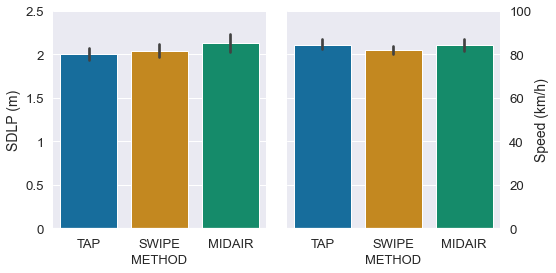

In [13]:
def double_cute_plot(df, x_label, x_label_name, x_order, y_label, y_label_name, y_bounds, title, fontsize):
    import seaborn as sns
    import matplotlib
    import matplotlib.pyplot as plt
    reg_palette = sns.color_palette("colorblind", 5)
    sns.set_palette(reg_palette)
    light_palette = [sns.set_hls_values(x, l=0.65) for x in reg_palette]
    sns.set_style("whitegrid")
    sns.set(font_scale = 1.2)
    
    fig = plt.figure()
    fig.set_figwidth(8)
    fig.set_figheight(4)
    gs = fig.add_gridspec(ncols=2, nrows=1, wspace=0.1)
    patches = []
    for i in range(len(y_label)):
        metric = y_label[i]
#     metric, palette = y_label, reg_palette
        ax = fig.add_subplot(gs[0, i])
        ax = sns.barplot(data=df, x=x_label, order=x_order, y=metric, label=metric, ci=95, ax=ax, n_boot=10000, \
                palette=reg_palette,)
        for k,t in enumerate(t.get_text() for t in ax.get_xticklabels()):
                patches.append(matplotlib.patches.Patch(color=reg_palette[k], label= metric + ' ' + t.upper()))
        ax.set_ylim(ymin=y_bounds[0], ymax=y_bounds[1])
        if i == 0:
            ax.yaxis.set_label_position("left")
#             ax.yaxis.tick_left()
            ax.yaxis.set_ticklabels([0, 0.5, 1, 1.5, 2, 2.5])
        else:
            ax.yaxis.set_label_position("right")
            ax.yaxis.tick_right()
            ax.tick_params(right=False)
#         ax.yaxis.set_ticklabels([])
        ax.set_xlabel(x_label_name.upper(), fontsize=fontsize)
        factorize_xticks(ax)
        ax.set_ylabel(y_label_name[i], fontsize=fontsize+1)
        # Remove spines
        ax.spines["right"].set_visible(False)
        ax.spines["left"].set_visible(False)
        ax.spines["top"].set_visible(False)
        ax.xaxis.set_ticklabels(ax.xaxis.get_ticklabels(), fontsize=fontsize) # Reduce tick label size for x axis
    #     ax.yaxis.set_ticklabels(ax.yaxis.get_ticklabels(), fontsize=fontsize) # Reduce tick label size for x axis
#     fig.tight_layout()
    fig.savefig('Figs/'+title+'.pdf', dpi=300)
    plt.show()
ndf = df.copy()
ndf['SDLP'] = ndf['SDLP'] * 40
double_cute_plot(ndf, 'Method', 'Method', new_modes, ['SDLP', 'Speed'], ['SDLP (m)', 'Speed (km/h)'], [0, 100], 'SDLP and Speed by Method', 13)

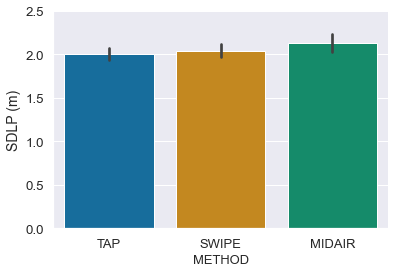

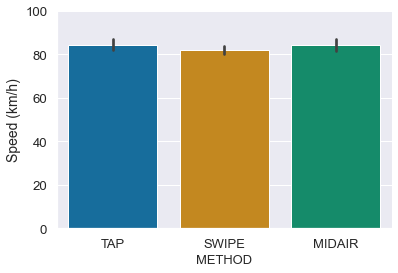

In [14]:
cute_plot(df, 'Method', 'Method', new_modes, 'SDLP', 'SDLP (m)', [0, 2.5], 'SDLP by Method', False, 'lower left', 13)
cute_plot(df, 'Method', 'Method', new_modes, 'Speed', 'Speed (km/h)', [0, 100], 'Average Speed by Method', False, 'lower left', 13)

In [15]:
import seaborn as sns
rows = []
for index, row in df.iterrows():
    rows.append([row['PID'], row['Method'], 'SDLP', row['SDLP']])
    rows.append([row['PID'], row['Method'], 'Speed', row['Speed']])
edf = pd.DataFrame(rows, columns = ['PID', 'Method', 'Metric', 'Value'])
edf

,PID,Method,Metric,Value
0,1,TAP,SDLP,1.863589
1,1,TAP,Speed,81.993636
2,1,TAP,SDLP,2.057248
3,1,TAP,Speed,77.538209
4,1,SWIPE,SDLP,2.083233
...,...,...,...,...
211,18,SWIPE,Speed,78.583787
212,18,MIDAIR,SDLP,2.368718
213,18,MIDAIR,Speed,79.513914
214,18,MIDAIR,SDLP,2.291471
